# Enhanced Correlation Coefficient Transverse Chromatic Aberration Correction
We use the following algorithm:
- Use a corner detector to find corners in the green channel (Shi-Tomasi or Harris)
- Pick top-k and find a fixed-size window around each
- Compute ECC transform and find displacement

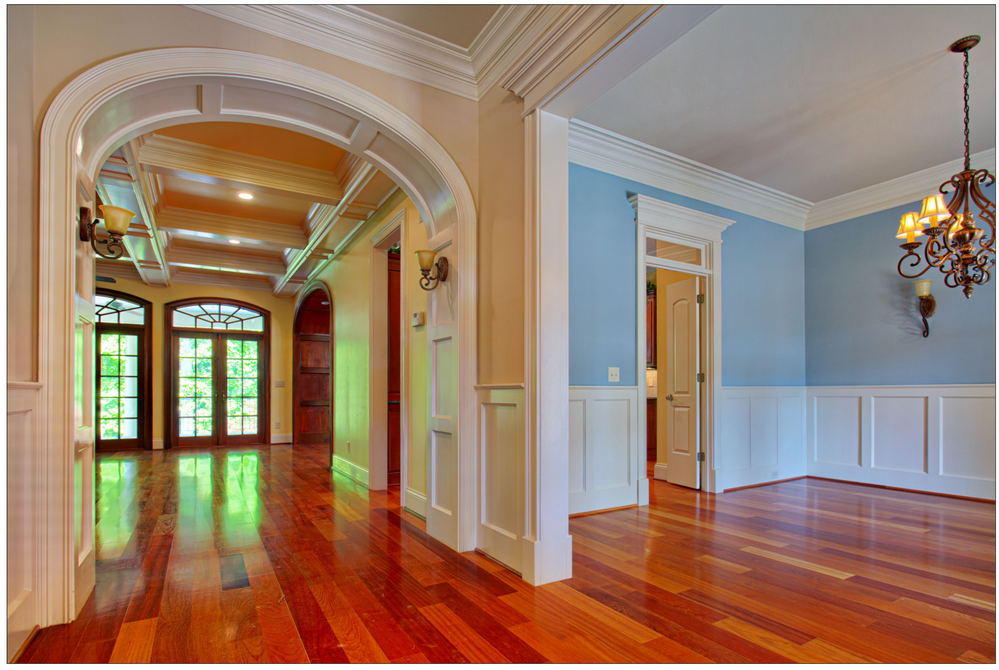

In [1]:
from imageio import imread
from matplotlib import pyplot as plt

# Load image
image = imread("../test/media/tca/1.jpg")

# Show
plt.figure(figsize=(30, 20))
plt.xticks([])
plt.yticks([])
plt.imshow(image, interpolation="bilinear")
plt.show()

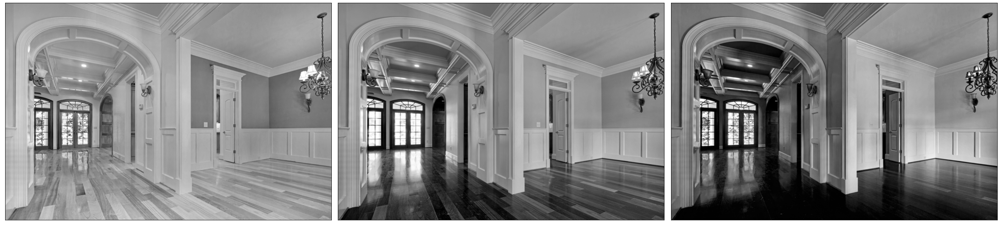

In [2]:
from numpy import split

# Split
r, g, b = split(image, 3, axis=2)

# Plot
plt.figure(figsize=(30, 20))
plt.gray()
plt.subplot(1, 3, 1)
plt.xticks([])
plt.yticks([])
plt.imshow(r, interpolation="bilinear")
plt.subplot(1, 3, 2)
plt.xticks([])
plt.yticks([])
plt.imshow(g, interpolation="bilinear")
plt.subplot(1, 3, 3)
plt.xticks([])
plt.yticks([])
plt.imshow(b, interpolation="bilinear")
plt.tight_layout()
plt.show()

Now, we find corners in the green channel:

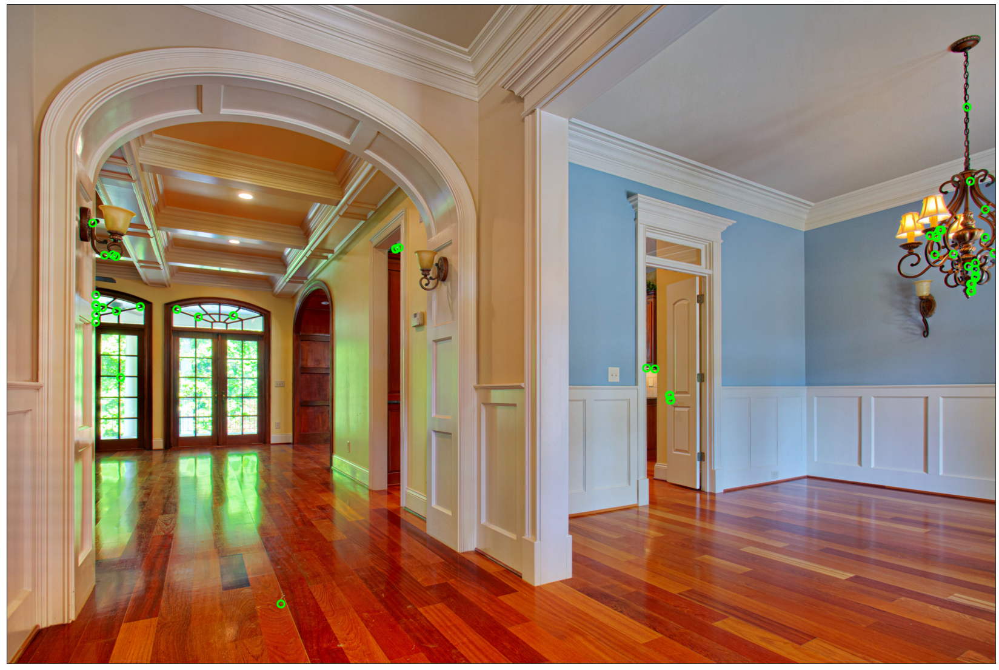

In [23]:
from cv2 import circle, cornerHarris
from numpy import argpartition, column_stack, float32, unravel_index

# Find corners
corners = cornerHarris(g.astype(float32), 2, 3, 0.04)

# Get coordinates
K = 100
corner_indices = argpartition(corners, -K, axis=None)[-K:]
y_coords, x_coords = unravel_index(corner_indices, corners.shape)
coords = column_stack((x_coords, y_coords))

# Draw circles around corners
corner_image = image.copy()
for coord in coords:
    x, y = coord
    circle(corner_image, (x, y), 20, (0,255,0), 10)

# Show
plt.figure(figsize=(30, 20))
plt.xticks([])
plt.yticks([])
plt.imshow(corner_image, interpolation="bilinear")
plt.show()

Now, we must fuse nearby corners so as not to overcount during the optimization. **INCOMPLETE**

In [47]:
# INCOMPLETE

Next, we collect a series of patches around these corners over which we can optimize:

In [34]:
from numpy import concatenate, ndarray, stack

def extract_patches (input: ndarray, centers: ndarray, size: int) -> ndarray:
    """
    Extract image patches given M centers.
    Note that the number of returned patches might be less than M, as patches that are not full-size are discarded.

    Parameters:
        input (ndarray): Input image with shape (H,W,C).
        centers (ndarray): Patch centers (x,y) coordinates with shape (M,2).
        size (int): Size in each dimension.

    Returns:
        ndarray: Patch stack with shape (N,S,S,C).
    """
    patches = []
    negatives = centers - size // 2
    positives = negatives + size
    extents = concatenate((negatives, positives), axis=1)
    for x_min, y_min, x_max, y_max in extents: # Wish there was a more Pythonic way to do this
        patch = input[y_min:y_max, x_min:x_max]
        if patch.shape[0] == patch.shape[1] == size:
            patches.append(patch)
    result = stack(patches)
    return result

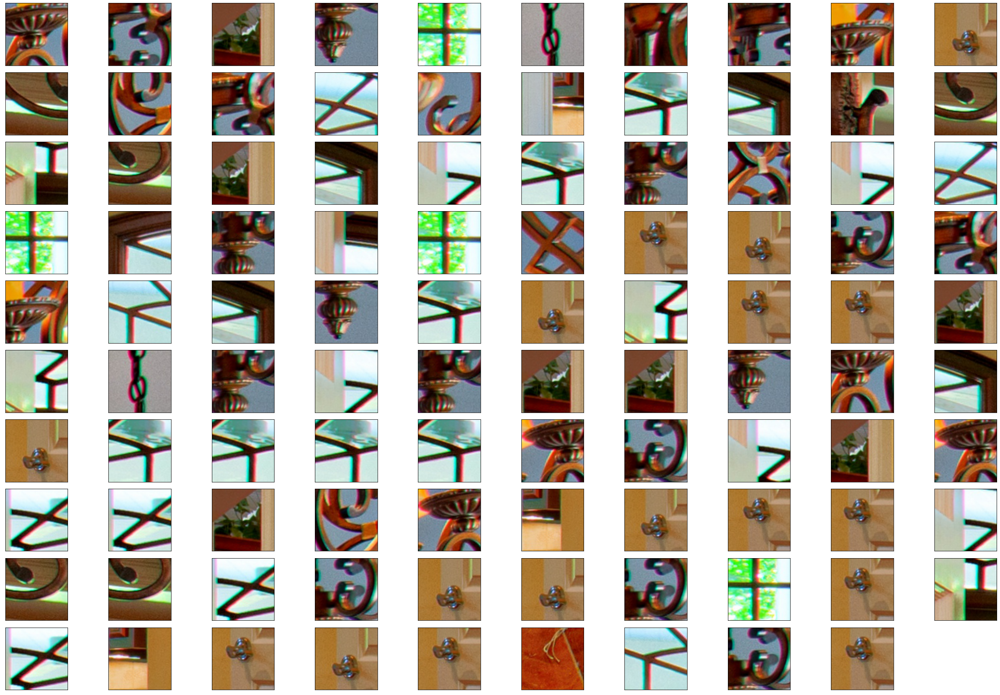

In [46]:
# Extract patches
patches = extract_patches(image, coords, 100)

# Display
plt.figure(figsize=(30, 20))
plt.tight_layout()
for i, patch in enumerate(patches):
    plt.subplot(10, 10, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(patch, interpolation="bilinear")
plt.tight_layout()
plt.show()

Next, we find the ECC transform for each patch:

In [77]:
from cv2 import findTransformECC, warpAffine, INTER_LINEAR, MOTION_TRANSLATION, TERM_CRITERIA_COUNT, TERM_CRITERIA_EPS, WARP_INVERSE_MAP
from numpy import eye

IDENTITY = eye(2, 3, dtype=float32)
CRITERIA = (TERM_CRITERIA_EPS | TERM_CRITERIA_COUNT, 100, 1e-4)

aligned_patches = []
translations = []

for patch in patches:
    try:
        patch_r, patch_g, patch_b = split(patch, 3, axis=2)
        _, warp_matrix_r = findTransformECC(patch_g, patch_r, IDENTITY.copy(), MOTION_TRANSLATION, CRITERIA, None, 5)
        _, warp_matrix_b = findTransformECC(patch_g, patch_b, IDENTITY.copy(), MOTION_TRANSLATION, CRITERIA, None, 5)
        patch_r_aligned = warpAffine(patch_r, warp_matrix_r, (100, 100), flags=INTER_LINEAR + WARP_INVERSE_MAP)
        patch_b_aligned = warpAffine(patch_b, warp_matrix_b, (100, 100), flags=INTER_LINEAR + WARP_INVERSE_MAP)
        aligned_patch = stack((patch_r_aligned, patch_g.squeeze(), patch_b_aligned), axis=2)
        aligned_patches.append(aligned_patch)
        translation = stack((warp_matrix_r[:,2], warp_matrix_b[:,2]), axis=0)
        translations.append(translation)
    except:
        pass

translations = stack(translations, axis=0)

Now, we evaluate the aligned patches.

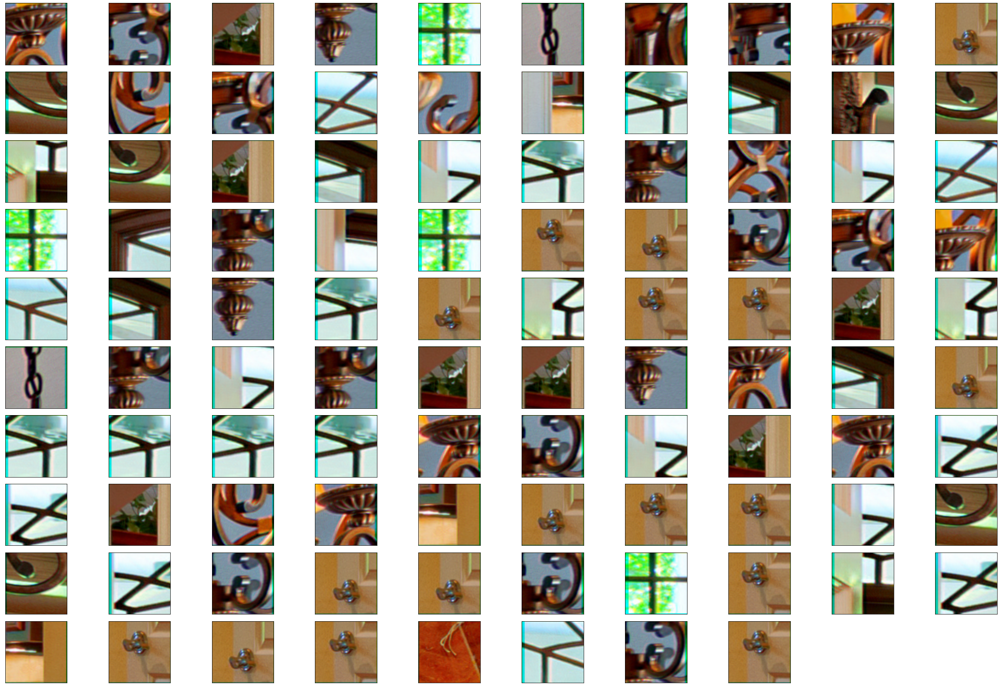

In [67]:
# Display
plt.figure(figsize=(30, 20))
plt.tight_layout()
for i, patch in enumerate(aligned_patches):
    plt.subplot(10, 10, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(patch, interpolation="bilinear")
plt.tight_layout()
plt.show()

Finally, we optimize a cubic radial lens distortion model: